In [29]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as  sns
import pandas as pd
from tqdm.notebook import tqdm

In [28]:
import torch
from torch import nn,optim
import torch.nn.functional as F
from torch.autograd import Variable
from torch.utils.data import Dataset,DataLoader

In [122]:
device='cpu'
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
torch.manual_seed(RANDOM_SEED)

In [68]:
df=pd.read_csv('Port Harcourt, Nigeria (4.80678 7.002953).csv')

In [69]:
df.head(5)

,created_at,entry_id,Temperature_F,Humidity_%,PM2.5_ATM_ug/m3
0,2021-07-26 16:45:59 UTC,198,89,50,40.78
1,2021-07-26 16:48:03 UTC,199,89,50,40.09
2,2021-07-26 16:49:59 UTC,200,89,50,37.93
3,2021-07-26 16:54:03 UTC,201,89,50,33.18
4,2021-07-26 16:55:59 UTC,202,89,50,37.84


In [70]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 56052 entries, 0 to 56051
Data columns (total 5 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   created_at       56052 non-null  object 
 1   entry_id         56052 non-null  int64  
 2   Temperature_F    56052 non-null  int64  
 3   Humidity_%       56052 non-null  int64  
 4   PM2.5_ATM_ug/m3  56052 non-null  float64
dtypes: float64(1), int64(3), object(1)
memory usage: 2.1+ MB


In [71]:
df.isnull().sum()

created_at         0
entry_id           0
Temperature_F      0
Humidity_%         0
PM2.5_ATM_ug/m3    0
dtype: int64

In [72]:
df.drop(columns='entry_id',inplace=True)

In [73]:
df['created_at']=pd.to_datetime(df['created_at'])

In [74]:
df.set_index('created_at',inplace=True)

In [17]:
df.index.unique()

DatetimeIndex(['2021-07-26 16:45:59+00:00', '2021-07-26 16:48:03+00:00',
               '2021-07-26 16:49:59+00:00', '2021-07-26 16:54:03+00:00',
               '2021-07-26 16:55:59+00:00', '2021-07-26 16:58:11+00:00',
               '2021-07-26 17:00:08+00:00', '2021-07-26 17:02:05+00:00',
               '2021-07-26 17:04:02+00:00', '2021-07-26 17:06:00+00:00',
               ...
               '2021-10-25 09:18:40+00:00', '2021-10-25 09:20:40+00:00',
               '2021-10-25 09:22:42+00:00', '2021-10-25 09:24:44+00:00',
               '2021-10-25 09:26:47+00:00', '2021-10-25 09:28:43+00:00',
               '2021-10-25 09:30:43+00:00', '2021-10-25 09:32:44+00:00',
               '2021-10-25 09:34:44+00:00', '2021-10-25 09:36:44+00:00'],
              dtype='datetime64[ns, UTC]', name='created_at', length=56052, freq=None)

In [13]:
df.head(5)

,entry_id,Temperature_F,Humidity_%,PM2.5_ATM_ug/m3
created_at,,,,
2021-07-26 16:45:59+00:00,198,89,50,40.78
2021-07-26 16:48:03+00:00,199,89,50,40.09
2021-07-26 16:49:59+00:00,200,89,50,37.93
2021-07-26 16:54:03+00:00,201,89,50,33.18
2021-07-26 16:55:59+00:00,202,89,50,37.84


In [26]:
import plotly.express as px

fig=px.line(df,x=df.index,y=['Temperature_F','Humidity_%','PM2.5_ATM_ug/m3'],title='Air Pollution at Port Harcourt, Nigeria')
fig.show()

Spike in the above graph diminished the other values by Particulate Matter Quantity

In [27]:
fig=px.line(df,x=df.index,y=['Temperature_F','Humidity_%'],title='Air Pollution at Port Harcourt, Nigeria')
fig.show()

<AxesSubplot:>

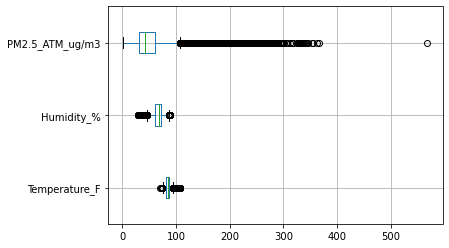

In [30]:
df.boxplot(column=['Temperature_F','Humidity_%','PM2.5_ATM_ug/m3'],vert=False)

There is large variation in Particulate matter as compared to other quantity

In [79]:
train_size=int(0.8*len(df))
train_df=df.loc[df.index[:train_size]].copy()
test_df=df.loc[df.index[train_size:]].copy()

In [81]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
train_df[['Temperature_F','Humidity_%','PM2.5_ATM_ug/m3']]=scaler.fit_transform(train_df[['Temperature_F','Humidity_%','PM2.5_ATM_ug/m3']])
test_df[['Temperature_F','Humidity_%','PM2.5_ATM_ug/m3']]=scaler.transform(test_df[['Temperature_F','Humidity_%','PM2.5_ATM_ug/m3']])

In [82]:
train_df.head(3)

,Temperature_F,Humidity_%,PM2.5_ATM_ug/m3
created_at,,,
2021-07-26 16:45:59+00:00,1.044842,-1.792397,-0.297193
2021-07-26 16:48:03+00:00,1.044842,-1.792397,-0.314074
2021-07-26 16:49:59+00:00,1.044842,-1.792397,-0.366920


In [151]:
len(train_df)

44801

In [152]:
class TimeSeries(Dataset):
    def __init__(self,df,target,features,sequence_length=6):
        self.features=features
        self.target=target
        self.sequence_length=sequence_length
        self.X=df[features].values
        self.y=df[target].values
    def make_sequence(self):
        X_=[]
        y_=[]
        L=len(self.X)
        for i in range(L-self.sequence_length):
            X_.append(self.X[i:i+self.sequence_length])
            y_.append(self.y[i+self.sequence_length])
        return torch.tensor(X_).float(),torch.tensor(y_).float()
    def __len__(self):
        return len(self.make_sequence()[0])
    def __getitem__(self,idx):
        X,y=self.make_sequence()
        return X[idx],y[idx]

In [153]:
target='PM2.5_ATM_ug/m3'
features=['Temperature_F','Humidity_%','PM2.5_ATM_ug/m3']
batch_size=30
sequence_length=20

In [154]:
train_ds=TimeSeries(train_df,target,features,sequence_length=sequence_length)
test_ds=TimeSeries(test_df,target,features,sequence_length=sequence_length)

In [155]:
len(train_ds)

44781

In [156]:
train_dl = DataLoader(train_ds, batch_size=batch_size, shuffle=True)
test_dl = DataLoader(test_ds, batch_size=batch_size, shuffle=False)

In [157]:
X, y = next(iter(train_dl))

print("Features shape:", X.shape)
print("Target shape:", y.shape)

Features shape: torch.Size([4, 20, 3])
Target shape: torch.Size([4])


In [123]:
class RegressionLSTM(nn.Module):
    def __init__(self,n_feature,n_hidden):
        super(RegressionLSTM,self).__init__()
        self.n_feature=n_feature
        self.n_hidden=n_hidden
        self.lstm=nn.LSTM(input_size=self.n_feature,hidden_size=self.n_hidden,batch_first=True,num_layers=1)
        self.linear=nn.Linear(in_features=self.n_hidden,out_features=1)
    def forward(self,x):
        batch_size = x.shape[0]
        h0 = torch.zeros(1, batch_size, self.n_hidden).requires_grad_()
        c0 = torch.zeros(1, batch_size, self.n_hidden).requires_grad_()
        _, (hn, _) = self.lstm(x, (h0, c0))
        out = self.linear(hn[0]).flatten()
        return out

In [124]:
model=RegressionLSTM(n_feature=3,n_hidden=10).to(device)
loss_function = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-5)

In [125]:
def running_model(dl,train=True):
    if train:
        model.train()
        total_loss=0.0
        for X, y in dl:
            X=Variable(X).to(device)
            y=Variable(y).to(device)
            output = model(X)
            loss = loss_function(output, y)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total_loss += round(loss.cpu().item(),5)

        avg_loss = total_loss / len(dl)
        print(f"Train loss: {avg_loss}")
    else:
        model.eval()
        with torch.no_grad():
            total_loss=0.0
            for X, y in dl:
                X=Variable(X).to(device)
                y=Variable(y).to(device)
                output = model(X)
                total_loss += round(loss_function(output, y).cpu().item(),5)

        avg_loss = total_loss / len(dl)
        print(f"Test loss: {avg_loss}")      

In [ ]:
# Running 10 epochs so as to tune the model parameters
for i in tqdm(range(10)):
    running_model(train_dl)
    if i%3==0:
        running_model(test_dl,train=False)  